# DCGAN Implementation
In this project, the research paper "UNSUPERVISED REPRESENTATION LEARNING WITH DEEP CONVOLUTIONAL GENERATIVE ADVERSARIAL NETWORKS" will be implemented.\
Link to the paper: https://arxiv.org/pdf/1511.06434.pdf 

# Abstract of paper
In order to bridge the gap between supervised and unsupervised CNNs, the author of the paper came up with a new class of networks - deep convolutional generative adversarial networks aka DCGANs. Throughout the paper, the model has been trained on various datasets to show that it performs well on various representations (such as objects as well as scenery) in both the generator and dicriminator parts of the model.

# The following will be achieved throughout the course of this paper
1.   Evaluate a set of constraints on topology of DCGANs that allows them to be stable while training on data.
2.   Convince good performance of trained dicriminator models for image classification.
3.   Visualize filters learnt by DCGANs.
4. Show that the generators have interesting vector arithmetic properties allowing for easy
manipulation of info in generated images/samples



# Details of training on the dataset
- Trained on LSUN, Imagenet-1k and Faces dataset
- Scaling of images to the range of tanh activation function [-1,1] 
- Trained with Mini-Batch Stochastic Gradient Descent with mini-batch size = 128
- Weights were initialized from Normal distribution with standard deviation 0.02 and mean = 0 
- Slope of Leaky ReLU 0.2
- Adam optimizer is used for training
- Learning rate = 0.0002 for best results
- Momentum term Beta1 = 0.5 instead of 0.9 to avoid oscillations & instability

# Information on datasets

## LSUN
The dataset can be found here: https://paperswithcode.com/dataset/lsun
- Contains 3 million samples of high resolution bedrooms.
- No data augmentation applied to the data
- Used to demonstrate how well the model handles more and high resolution data
- De-duplication done to prevent overfitting (removed 275k samples)

## FACES
The dataset can be found here: https://www.kaggle.com/datasets/ashwingupta3012/human-faces
- This dataset contains 3 million images of over 10000 people
-  No data augmentation was applied to the images
- OpenCV face detection model was used on the dataset to generate about 350k face boxes which were used for training

## Imagenet-1k
The dataset can be found here: https://www.image-net.org/download.php
- This dataset contains natural images for unspuervised learning
- We train on images of size 64 X 64
- No data augmentation was applied to the images

## CIFAR-10
The dataset can be found here: https://www.cs.toronto.edu/~kriz/cifar.html
- We will be performing classification of CIFAR-10 dataset using GANs as feature extractor.
-The CIFAR-10 dataset consists of 60000 32x32 colour images in 10 classes, with 6000 images per class. 
-There are 50000 training images and 10000 test images. 
-Here are the classes in the dataset: airplane, automobile, bird, cat, deer, dog, frog, horse, ship, truck




##SVHN
The SVHN dataset can be found here: https://www.kaggle.com/datasets/hugovallejo/street-view-house-numbers-svhn-dataset-numpy

- There are 73257 digits for training and 26032 digits for testing
- All images are 32X32 in size
- There are 10 classes, 1 for each digit. Digit '1' has label 1, '9' has label 9 and '0' has label 10.

#Importing Libraries and Modules

In [ ]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
import matplotlib.pyplot as plt
from os.path import exists
import torch
from torch import nn
from torch import optim
import torch.nn.functional as F
from torchvision import datasets, transforms
from google.colab import files


In [ ]:


from __future__ import print_function
import os
import numpy as np
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
!pip install gdown

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# Defining DCGAN architecture

In [ ]:
cudnn.benchmark = True
#set seed to constant
seed = random.randint(1, 10000)
random.seed(seed)
torch.manual_seed(seed)
#check the availability of cuda devices
device = 'cuda' if torch.cuda.is_available() else 'cpu'
# number of gpu's available
ngpu = 1
 

In [ ]:
if torch.cuda.is_available():
  device = torch.device("cuda")
else:
  device = torch.device("cpu")

In [ ]:
# random weights initialization of netG and netD as given in paper
#Gaussian distribution with S.D. = 0.02
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

#generator class for DCGAN architecture
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(100, 64 * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(64 * 8),
            nn.ReLU(True),
            # state size. (64*8) x 4 x 4
            nn.ConvTranspose2d(64 * 8, 64 * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 4),
            nn.ReLU(True),
            # state size. 64*4 x 8 x 8
            nn.ConvTranspose2d(64 * 4, 64 * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 2),
            nn.ReLU(True),
            # state size. 64*2 x 16 x 16
            nn.ConvTranspose2d(64 * 2, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            # state size. (64) x 32 x 32
            nn.ConvTranspose2d(64, 3, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (3) x 64 x 64
        )
        
    def forward(self, input):
        if input.is_cuda and self.ngpu > 1:
            output = nn.parallel.data_parallel(self.main, input, range(self.ngpu))
        else:
            output = self.main(input)
            return output
#discriminator class for DCGAN architecture
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (3) x 64 x 64
            nn.Conv2d(3, 64, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (64) x 32 x 32
            nn.Conv2d(64, 64 * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (64*2) x 16 x 16
            nn.Conv2d(64 * 2, 64 * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (64*4) x 8 x 8
            nn.Conv2d(64 * 4, 64 * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (64*8) x 4 x 4
            nn.Conv2d(64 * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

#fucntion for forward pass on model
    def forward(self, input):
        if input.is_cuda and self.ngpu > 1:
            output = nn.parallel.data_parallel(self.main, input, range(self.ngpu))
        else:
            output = self.main(input)

        return output.view(-1, 1).squeeze(1)




In [ ]:
def trainDCGAN(dataloader,dataset,max_iterations,chkpt=5):
  
  #create generator instance with DCGAN architecture
  netG = Generator(ngpu).to(device)
  #load initialized weights  
  netG.apply(weights_init)
  print(netG)
 
  #create discriminator instance with DCGAN architecture
  netD = Discriminator(ngpu).to(device)
  #load initialized weights  
  netD.apply(weights_init)
  print(netD)

  #cross entropy loss for training the model
  criterion = nn.BCELoss()

  # setup optimizer
  optimizerD = optim.Adam(netD.parameters(), lr=0.0002, betas=(0.5, 0.999))
  optimizerG = optim.Adam(netG.parameters(), lr=0.0002, betas=(0.5, 0.999))

  #fixed noise vector for comparison between generated images 
  fixed_noise = torch.randn(128, 100, 1, 1, device=device)
  real_label = 1
  fake_label = 0

  niter = max_iterations

  for epoch in range(niter):
      for i, data in enumerate(dataloader, 0):
          #Update Discriminator
          # train with real data 
          netD.zero_grad()
          #transfer data to device where model is loaded (GPU/CPU) for training
          data = data[0].to(device)
          batch_size = data.size(0)
          #set label of all images from dataset as real 
          label = torch.full((batch_size,), real_label, device=device)
          
          #calculate loss for Discriminator on current batch data
          output = netD(data)
          errD_real = criterion(output.float(), label.float())
          #backpropagation
          errD_real.backward()
          D_x = output.mean().item()

          # train with fake data generated by Generator 
          noise = torch.randn(batch_size, 100, 1, 1, device=device)
          #generate fake image using random noise vector
          fake = netG(noise)
          #set label of all images as fake 
          label.fill_(fake_label)
          #detach because gradient isn't to be computed 
          output = netD(fake.detach())
          #calculate error on fake data
          errD_fake = criterion(output.float(), label.float())
          errD_fake.backward()
          D_G_z1 = output.mean().item()
          #total error = error on real data+fake(generated data)
          errD = errD_real + errD_fake
          #update weights
          optimizerD.step()

         #Update Generator
          netG.zero_grad()
          label.fill_(real_label)  # fake labels are real for generator cost
          output = netD(fake)
          errG = criterion(output.float(), label.float())
          #backward propagation
          errG.backward()
          D_G_z2 = output.mean().item()
          #update generator weights
          optimizerG.step()
          #display losses 
          print('[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f D(x): %.4f D(G(z)): %.4f / %.4f' % (epoch, niter, i, len(dataloader), errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
          
          #save the output 
          g_loss.append(errG.item())
          d_loss.append(errD.item())
          #save real and fake images generated by DCGAN once each epoch
          if i % 50 == 0:
              print("Saving generated output image")
              vutils.save_image(data,f'/content/gdrive/MyDrive/images/{dataset}/real_sample.png',normalize=True)
              fake = netG(fixed_noise)
              img = fake.detach().cpu()
              #append generated fake image to images list
               
              images.append(np.transpose(vutils.make_grid(img, padding=2, normalize=True), (1,2,0)))
              vutils.save_image(img,f'/content/gdrive/MyDrive/images/{dataset}/fake_samples_epoch_{epoch+1}.png',normalize=True)
      
      # save model checkpoints once in chkpt epochs
      if((epoch+1)%chkpt==0):
        gpath = f"{dataset}_netG_epoch{epoch+1}.pth"
        dpath = f"{dataset}_netD_epoch{epoch+1}.pth"
        dest = f"/content/gdrive/MyDrive/models/{dataset}"

        #save generator model
        torch.save(netG.state_dict(), gpath)
        !cp -r {gpath} {dest}
        #save discriminator model
        torch.save(netD.state_dict(), dpath)
        !cp -r {dpath} {dest}
        

In [ ]:
#helper function to display images 
def imshow(img):
    image = np.transpose(img[0].cpu().detach().numpy()[0], (1, 2, 0))
    #convert to numpy from tensor
    print(image.shape)
    plt.imshow(image)


In [ ]:
#resize image to 64*64 and convert to tensor
#normalize pixel values to make their range = [-1,1] = range of tanh function
img_transform = transforms.Compose([
                               transforms.Resize((64,64)),
                               
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ])


#Training DCGAN on ImageNet-1k dataset

##Loading ImageNet-1k dataset 

In [ ]:
!pip install -q kaggle
from google.colab import files
files.upload()
#json file has to be uploaded for downloading from kaggle 

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"prajwalkalpande","key":"e56a8b68175b67502fe10ec4e53be16e"}'}

In [ ]:
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets download -d akash2sharma/tiny-imagenet
#download dataset

100% 474M/474M [00:04<00:00, 133MB/s]
100% 474M/474M [00:04<00:00, 110MB/s]


In [ ]:
!mkdir train
!unzip tiny-imagenet.zip -d train
#unzip file 

Streaming output truncated to the last 5000 lines.
  inflating: train/tiny-imagenet-200/val/images/val_5500.JPEG  
  inflating: train/tiny-imagenet-200/val/images/val_5501.JPEG  
  inflating: train/tiny-imagenet-200/val/images/val_5502.JPEG  
  inflating: train/tiny-imagenet-200/val/images/val_5503.JPEG  
  inflating: train/tiny-imagenet-200/val/images/val_5504.JPEG  
  inflating: train/tiny-imagenet-200/val/images/val_5505.JPEG  
  inflating: train/tiny-imagenet-200/val/images/val_5506.JPEG  
  inflating: train/tiny-imagenet-200/val/images/val_5507.JPEG  
  inflating: train/tiny-imagenet-200/val/images/val_5508.JPEG  
  inflating: train/tiny-imagenet-200/val/images/val_5509.JPEG  
  inflating: train/tiny-imagenet-200/val/images/val_551.JPEG  
  inflating: train/tiny-imagenet-200/val/images/val_5510.JPEG  
  inflating: train/tiny-imagenet-200/val/images/val_5511.JPEG  
  inflating: train/tiny-imagenet-200/val/images/val_5512.JPEG  
  inflating: train/tiny-imagenet-200/val/images/val_55

In [ ]:
#copy dataset into gdrive 
!cp -r '/content/train/tiny-imagenet-200/val' '/content/gdrive/MyDrive/data/'


In [ ]:
dataset = "ImageNet1k"
!mkdir {dataset}
#make folder to save output images of model trained on ImageNet1k

## Data Pre-Processing 

In [ ]:
#create pytorch dataloader for training from ImageNet dataset
train_dataset = datasets.ImageFolder('/content/train/tiny-imagenet-200/val', transform=img_transform)
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=128, shuffle=True)

In [ ]:
print(train_dataloader.dataset)

Dataset ImageFolder
    Number of datapoints: 10000
    Root location: /content/train/tiny-imagenet-200/val
    StandardTransform
Transform: Compose(
               Resize(size=(64, 64), interpolation=bilinear, max_size=None, antialias=warn)
               ToTensor()
               Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
           )


(64, 64, 3)


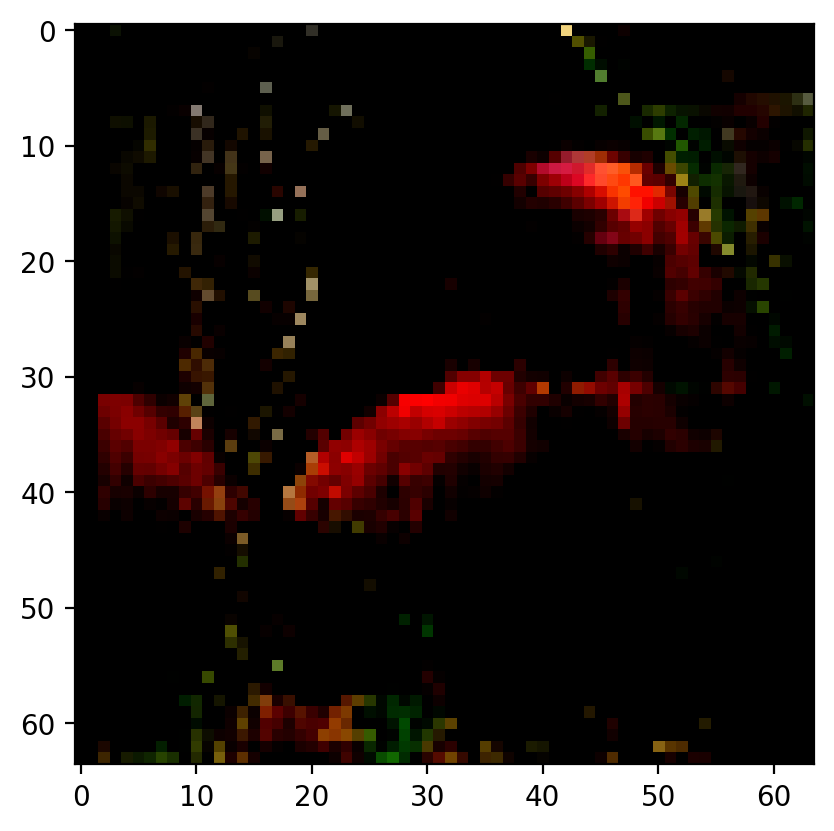

In [ ]:
imshow(next(iter(train_dataloader)))
#diplaying first image from dataset

##Training

In [ ]:
#initializing losses and image lists for GAN 
g_loss = []
d_loss = []
images =[]

In [ ]:
trainDCGAN(train_dataloader,"ImageNet1k",40,5)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


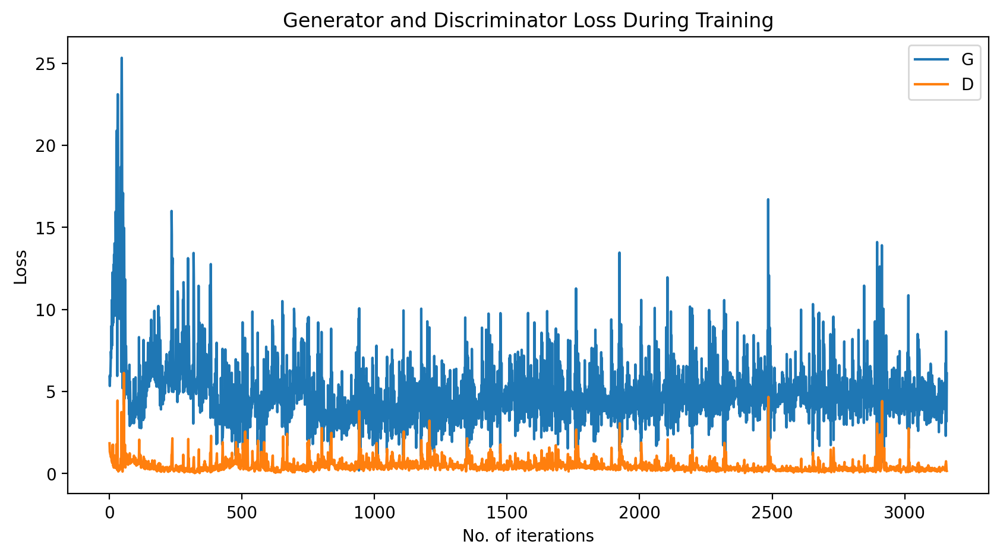

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(g_loss,label="G")
plt.plot(d_loss,label="D")
plt.xlabel("No. of iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

## Results

In [ ]:
#load generator model checkpoint
genmodel = Generator(ngpu).to(device)
genmodel.load_state_dict(torch.load('ImageNet1k_netG_epoch40.pth'))

<All keys matched successfully>

In [ ]:
#load discriminator model checkpoint
Dmodel = Discriminator(ngpu).to(device)
Dmodel.load_state_dict(torch.load('ImageNet1k_netD_epoch40.pth'))

<All keys matched successfully>

tensor([0.0099], device='cuda:0')


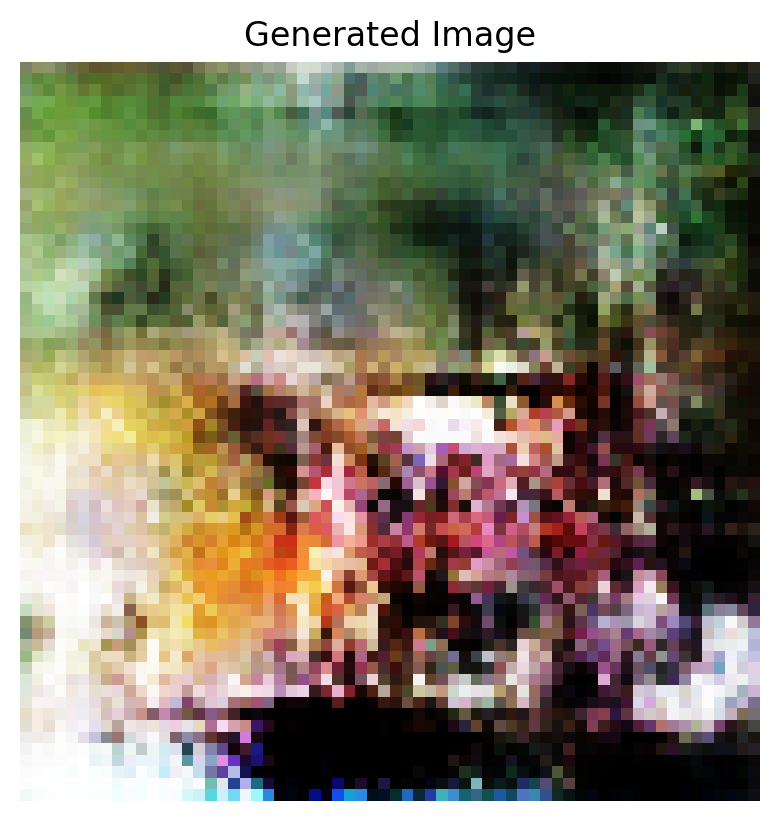

tensor([0.2805], device='cuda:0')


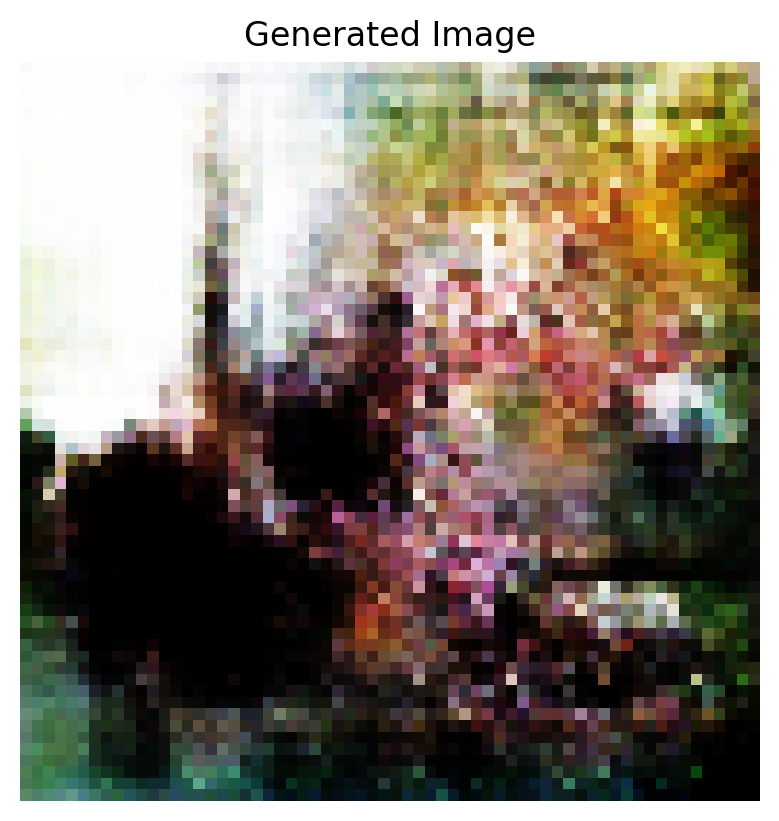

tensor([0.0009], device='cuda:0')


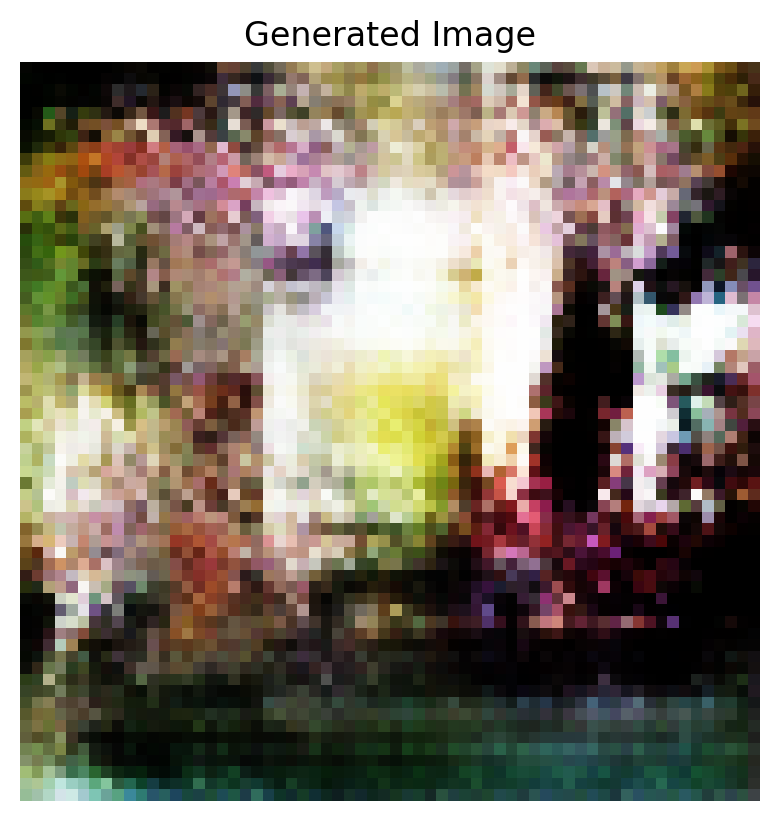

In [ ]:
for i in range(3):
  # Turn off gradient calculation to speed up processing
    with torch.no_grad():
    # Get generated image from the noise vector using the trained generator 
      noise = torch.randn(1, 100, 1, 1, device=device)
      generated_img = genmodel(noise)
      print(Dmodel(generated_img))
      img = generated_img.detach().cpu()
      
    # Display the generated image
    plt.axis("off")
    plt.title("Generated Image")
    plt.imshow(np.transpose(vutils.make_grid(img, padding=2, normalize=True), (1,2,0)))
    plt.show()


In [ ]:
real_img, label =  next(iter(train_dataloader))
print(real_img.shape)
print(Dmodel(real_img.to(device)))

torch.Size([128, 3, 64, 64])
tensor([0.9987, 0.9994, 0.9990, 0.9994, 0.9962, 0.9697, 0.9993, 0.9993, 0.9903,
        0.9997, 0.9978, 0.9973, 0.9990, 0.9999, 0.9842, 0.9981, 0.9997, 0.9928,
        0.9923, 0.9993, 1.0000, 0.9988, 0.9976, 0.9995, 0.9991, 0.9998, 0.9992,
        0.9996, 1.0000, 0.9939, 0.9999, 0.9986, 0.9994, 0.9925, 0.9793, 0.9955,
        0.9993, 0.9988, 0.9975, 0.9991, 0.9949, 0.9855, 1.0000, 0.9973, 0.9951,
        0.9994, 1.0000, 1.0000, 0.9995, 0.9988, 0.9999, 0.9989, 0.9980, 0.9976,
        0.9999, 0.9983, 0.9911, 0.9982, 0.9964, 0.9982, 0.9991, 0.9929, 0.9963,
        0.9977, 0.9988, 0.9958, 0.9991, 0.9990, 0.9994, 0.9991, 0.9976, 0.9982,
        0.9956, 0.9998, 0.9998, 0.9931, 0.9759, 0.9935, 0.9993, 0.9991, 0.9974,
        0.9987, 0.9986, 0.9832, 0.9988, 0.9799, 0.9994, 0.9971, 0.9994, 0.9996,
        0.9998, 0.9884, 0.9994, 1.0000, 0.9965, 0.9927, 0.9488, 0.9989, 0.9983,
        0.9969, 0.9995, 0.9998, 0.9977, 0.9958, 0.9837, 0.9993, 0.9999, 0.9967,
        0.9

In [ ]:
images[0].size() #gride of fake images generated in different epochs by Generator while training

torch.Size([1058, 530, 3])

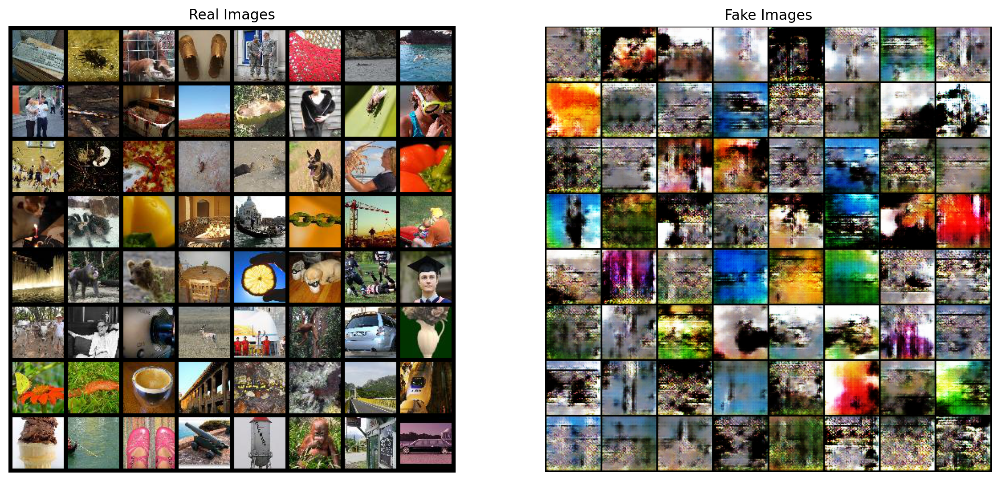

In [ ]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(train_dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(images[-1][529:])
plt.show()

In [ ]:
animate_images=[]
for i in range(len(images)):
  if((i+1)%3==0):
    animate_images.append(images[i])

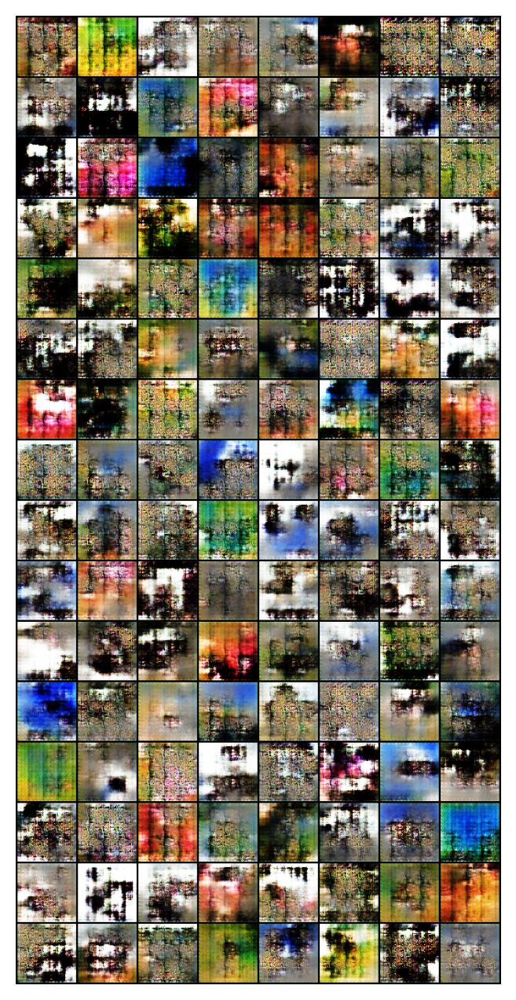

In [ ]:
import matplotlib
import matplotlib.animation as animation
from IPython.display import HTML
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(i, animated=True)] for i in animate_images]
#animating images generated by model at different stages of training
ani = animation.ArtistAnimation(fig, ims, interval=500, repeat_delay=500, blit=True)

HTML(ani.to_jshtml())

In [ ]:
ani.save('/content/gdrive/MyDrive/DCGANTraining.gif')

#Training DCGAN on Human Faces dataset

## Loading Faces dataset 

In [ ]:
!gdown --fuzzy https://drive.google.com/file/d/1C8LfmS2tdOAHWAptn9cDSyFelYWizNIy/view?usp=sharing 
#download faces dataset

Downloading...
From: https://drive.google.com/uc?id=1C8LfmS2tdOAHWAptn9cDSyFelYWizNIy
To: /content/faces_zip.zip
100% 1.95G/1.95G [00:23<00:00, 84.9MB/s]


In [ ]:
!unzip /content/faces_zip.zip -d faces

Streaming output truncated to the last 5000 lines.
  inflating: faces/Humans/1 (2910).jpg  
  inflating: faces/Humans/1 (2911).jpg  
  inflating: faces/Humans/1 (2912).jpg  
  inflating: faces/Humans/1 (2913).jpg  
  inflating: faces/Humans/1 (2914).jpg  
  inflating: faces/Humans/1 (2915).jpg  
  inflating: faces/Humans/1 (2916).jpg  
  inflating: faces/Humans/1 (2917).jpg  
  inflating: faces/Humans/1 (2918).jpg  
  inflating: faces/Humans/1 (2919).jpg  
  inflating: faces/Humans/1 (292).jpg  
  inflating: faces/Humans/1 (2920).jpg  
  inflating: faces/Humans/1 (2921).jpg  
  inflating: faces/Humans/1 (2922).jpg  
  inflating: faces/Humans/1 (2923).jpg  
  inflating: faces/Humans/1 (2924).jpg  
  inflating: faces/Humans/1 (2925).jpg  
  inflating: faces/Humans/1 (2926).jpg  
  inflating: faces/Humans/1 (2927).jpg  
  inflating: faces/Humans/1 (2928).jpg  
  inflating: faces/Humans/1 (2929).jpg  
  inflating: faces/Humans/1 (293).jpg  
  inflating: faces/Humans/1 (2930).jpg  
  inflat

##Data Pre-Processing


In [ ]:
#create pytorch dataloader for training 
train_faces_dataset = datasets.ImageFolder('/content/faces/', transform=img_transform)
train_faces_dataloader = torch.utils.data.DataLoader(train_faces_dataset, batch_size=128, shuffle=True)

In [ ]:
next(iter(train_faces_dataloader))[0].numpy().shape

(128, 3, 64, 64)

In [ ]:
print(train_faces_dataloader.dataset)

Dataset ImageFolder
    Number of datapoints: 7219
    Root location: /content/train/
    StandardTransform
Transform: Compose(
               Resize(size=(64, 64), interpolation=bilinear, max_size=None, antialias=warn)
               ToTensor()
               Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
           )


(64, 64, 3)


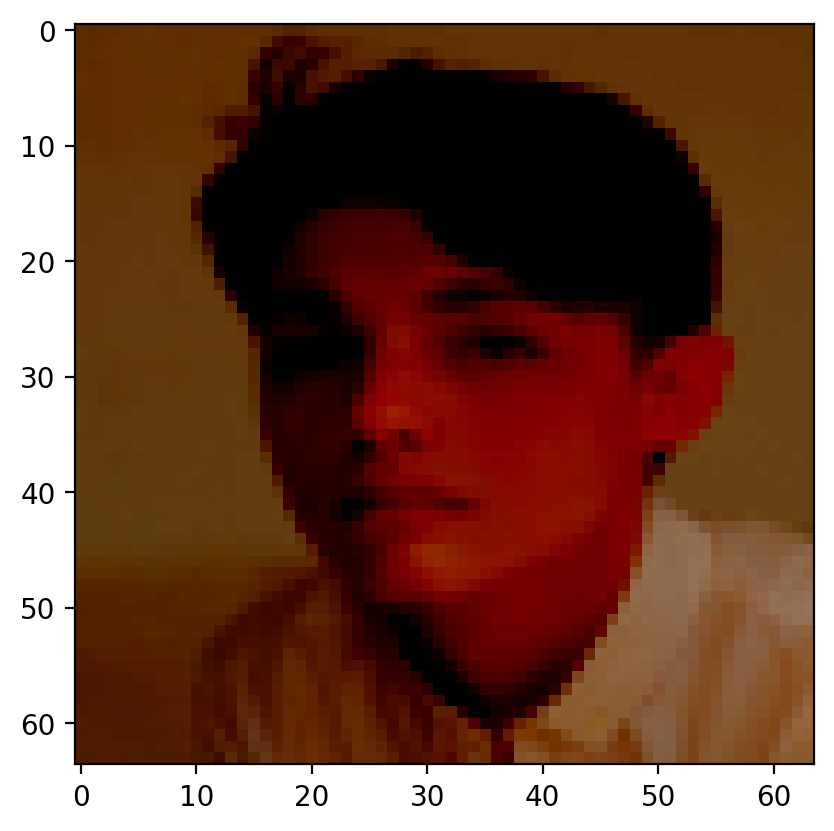

In [ ]:
imshow(next(iter(train_faces_dataloader)))

In [ ]:
dataset = "Faces"
!mkdir {dataset}

##Training 

In [ ]:
#initializing losses and image lists for GAN 
g_loss = []
d_loss = []
images =[]

In [ ]:
trainDCGAN(train_faces_dataloader,"Faces",15,3)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


[0/15][1/57] Loss_D: 3.1938 Loss_G: 3.6260 D(x): 0.9444 D(G(z)): 0.9145 / 0.0473
[0/15][2/57] Loss_D: 1.4297 Loss_G: 6.2745 D(x): 0.8949 D(G(z)): 0.6453 / 0.0034
[0/15][3/57] Loss_D: 0.7171 Loss_G: 5.9805 D(x): 0.7338 D(G(z)): 0.1817 / 0.0043
[0/15][4/57] Loss_D: 0.9556 Loss_G: 5.6756 D(x): 0.7611 D(G(z)): 0.3631 / 0.0056
[0/15][5/57] Loss_D: 1.0685 Loss_G: 6.9221 D(x): 0.7870 D(G(z)): 0.4301 / 0.0015
[0/15][6/57] Loss_D: 0.7668 Loss_G: 6.6556 D(x): 0.7396 D(G(z)): 0.2179 / 0.0020
[0/15][7/57] Loss_D: 0.7480 Loss_G: 7.3516 D(x): 0.8156 D(G(z)): 0.2859 / 0.0011
[0/15][8/57] Loss_D: 0.7176 Loss_G: 7.9857 D(x): 0.8012 D(G(z)): 0.2587 / 0.0006
[0/15][9/57] Loss_D: 0.8276 Loss_G: 7.7139 D(x): 0.7705 D(G(z)): 0.2058 / 0.0009
[0/15][10/57] Loss_D: 0.6893 Loss_G: 9.5445 D(x): 0.8558 D(G(z)): 0.3189 / 0.0001
[0/15][11/57] Loss_D: 0.4596 Loss_G: 8.0842 D(x): 0.8356 D(G(z)): 0.0983 / 0.0005
[0/15][12/57] Loss_D: 0.6987 Loss_G: 9.2546 D(x): 0.8014 D(G(z)): 0.2552 / 0.0002
[0/15][13/57] Loss_D: 0.4

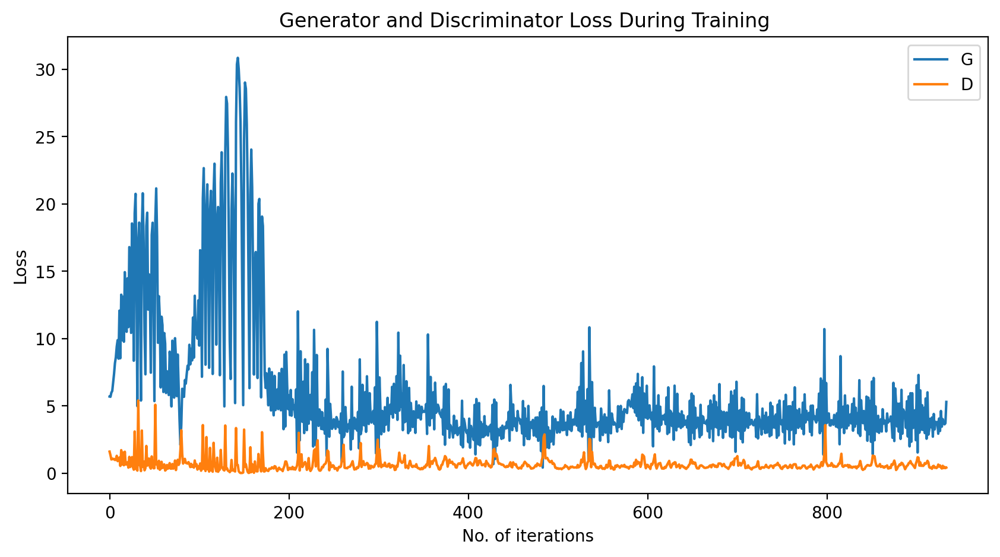

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training ")
plt.plot(g_loss,label="G")
plt.plot(d_loss,label="D")
plt.xlabel("No. of iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

## Results

In [ ]:
#load generator model checkpoint (most recent one)
genmodel = Generator(ngpu).to(device)
genmodel.load_state_dict(torch.load('Faces_netG_epoch15.pth'))
#load generator model checkpoint (most recent one)
Dmodel = Discriminator(ngpu).to(device)
Dmodel.load_state_dict(torch.load('Faces_netD_epoch15.pth'))

<All keys matched successfully>

tensor([0.0176], device='cuda:0')


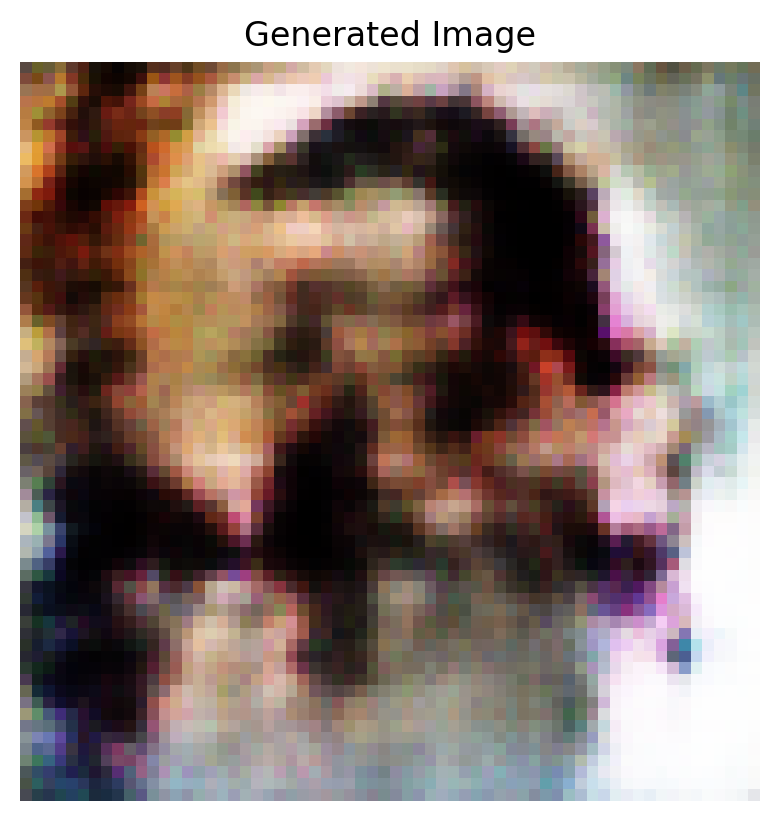

tensor([0.0170], device='cuda:0')


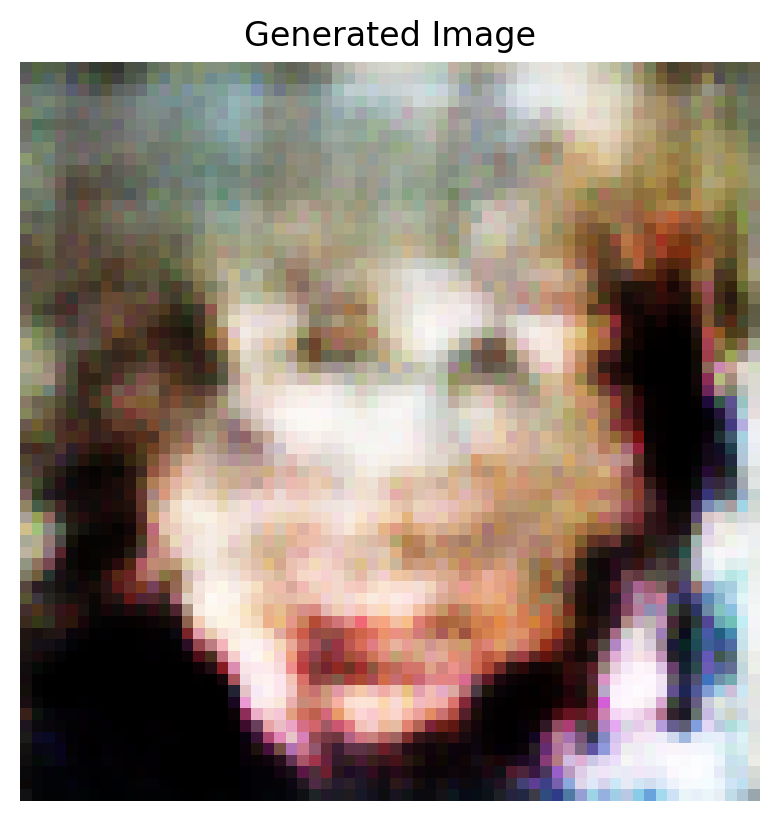

tensor([0.0143], device='cuda:0')


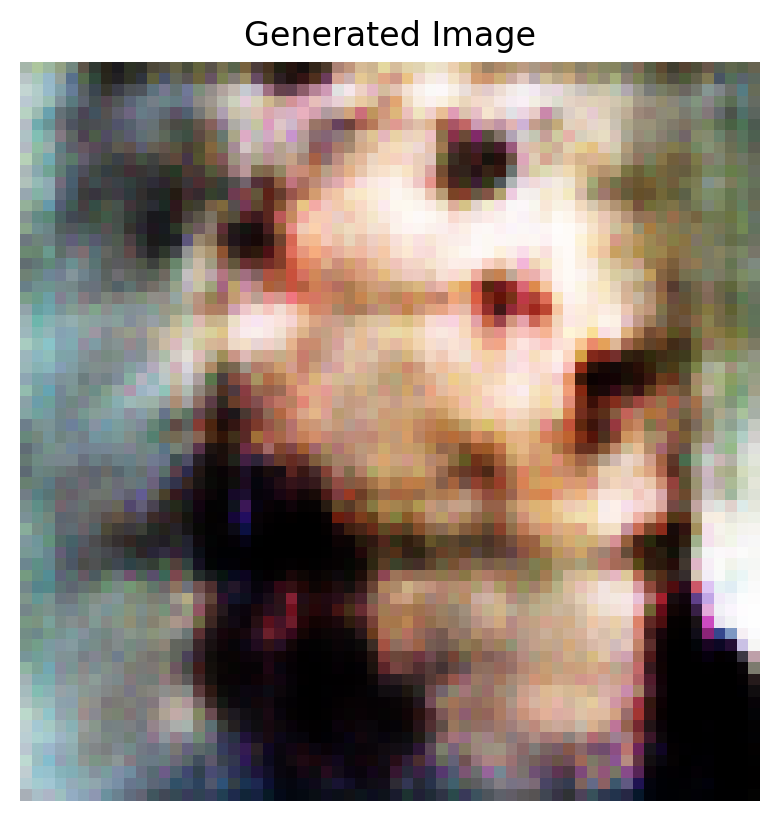

In [ ]:
# Turn off gradient calculation
for i in range(3):
    with torch.no_grad():
    # Get generated image from the noise vector using trained generator
    
      noise = torch.randn(1, 100, 1, 1, device=device)
      generated_img = genmodel(noise)
      print(Dmodel(generated_img))
      img = generated_img.detach().cpu()
      
    # Display the generated image.
    plt.axis("off")
    plt.title("Generated Image")
    plt.imshow(np.transpose(vutils.make_grid(img, padding=2, normalize=True), (1,2,0)))

    plt.show()


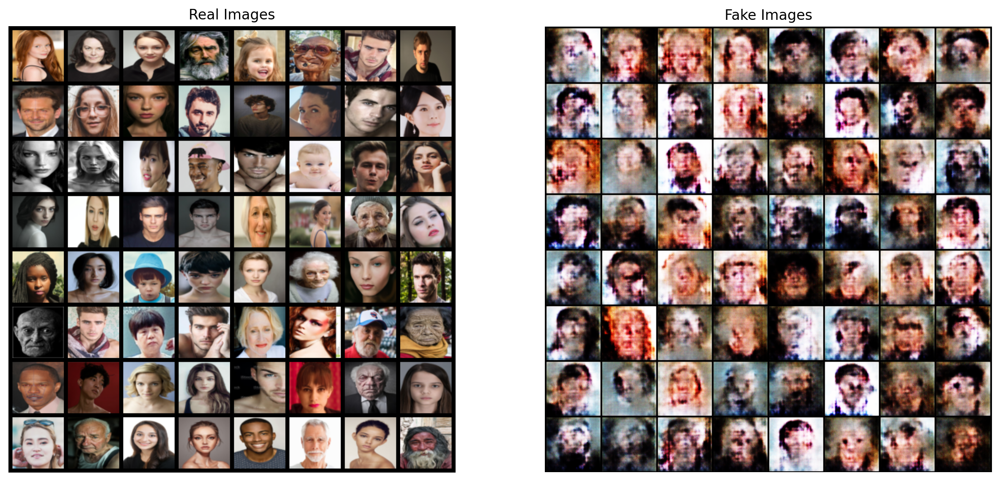

In [ ]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(train_faces_dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(images[-1][0:529])
plt.show()

#Training DCGAN on LSUN dataset

## Loading LSUN dataset 

In [ ]:
!pip install -q kaggle
files.upload()
#json file has to be uploaded for downloading from kaggle 

Saving kaggle.json to kaggle (1).json


{'kaggle.json': b'{"username":"prajwalkalpande","key":"e56a8b68175b67502fe10ec4e53be16e"}'}

In [ ]:
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

mkdir: cannot create directory ‘/root/.kaggle’: File exists


In [ ]:
!kaggle datasets download -d ajaykgp12/lsunchurch
#download Large-scale Scene Understanding (LSUN) dataset

lsunchurch.zip: Skipping, found more recently modified local copy (use --force to force download)


In [ ]:
!mkdir train
!unzip /content/lsun_zip.zip -d lsun
#unzip file 

mkdir: cannot create directory ‘train’: File exists
Archive:  /content/lsun_zip.zip
  inflating: lsun/church_outdoor_train_lmdb_color_64.npy  


In [ ]:
# !gdown --fuzzy https://drive.google.com/file/d/1m7GF_2AEhblE6wm7VZrKgvYPKvHZP7mT/view?usp=share_link
# #download Large-scale Scene Understanding (LSUN) dataset

Downloading...
From: https://drive.google.com/uc?id=1m7GF_2AEhblE6wm7VZrKgvYPKvHZP7mT
To: /content/lsun_zip.zip
100% 1.27G/1.27G [00:18<00:00, 68.3MB/s]


##Data Pre-Processing


In [ ]:
import numpy as np
lsun_data = np.load('/content/lsun/church_outdoor_train_lmdb_color_64.npy')

In [ ]:
lsun_data.shape


(126227, 64, 64, 3)

In [ ]:
lsun_data = lsun_data[:50000]
#take only first 10000 images

In [ ]:
lsun_data.shape

(50000, 64, 64, 3)

In [ ]:
lsun_data = (lsun_data - 127.5) / 127.5  # Normalize the images to [-1, 1]

In [ ]:
lsun_data = np.transpose(lsun_data,(0,3,1,2)) #switch dimensions to batchsize,channels,height,width
lsun_data = lsun_data[:,None,:,:,:]

In [ ]:
lsun_data.shape

(50000, 1, 3, 64, 64)

In [ ]:

from torch.utils.data import TensorDataset

train_LSUN_dataset = torch.Tensor(lsun_data) # transform to torch tensor

#create pytorch dataloader for training 
train_LSUN_dataloader = torch.utils.data.DataLoader(train_LSUN_dataset, batch_size=128, shuffle=True)

In [ ]:
print(train_LSUN_dataloader.dataset[0])

tensor([[[-0.2392, -0.2235, -0.2314,  ..., -0.0431, -0.0039, -0.1294],
         [-0.2392, -0.2235, -0.2314,  ..., -0.1451, -0.0980, -0.0510],
         [-0.2314, -0.2314, -0.2314,  ..., -0.0431, -0.0980, -0.0824],
         ...,
         [-0.8118, -0.7882, -0.7725,  ..., -0.8196, -0.6863, -0.7647],
         [-0.9608, -0.9373, -0.9529,  ..., -1.0000, -0.8902, -0.9137],
         [-0.8902, -0.8118, -0.9137,  ..., -0.0118, -1.0000, -0.9216]],

        [[ 0.0510,  0.0667,  0.0588,  ..., -0.1451, -0.1529, -0.2392],
         [ 0.0510,  0.0667,  0.0588,  ..., -0.2471, -0.2471, -0.1765],
         [ 0.0588,  0.0588,  0.0588,  ..., -0.1451, -0.2471, -0.2157],
         ...,
         [-0.8039, -0.7804, -0.7647,  ..., -0.8196, -0.6863, -0.7647],
         [-0.9529, -0.9294, -0.9451,  ..., -1.0000, -0.8902, -0.9137],
         [-0.8824, -0.8039, -0.9059,  ..., -0.0039, -1.0000, -0.9216]],

        [[ 0.6078,  0.6235,  0.6157,  ..., -0.2706, -0.2863, -0.3412],
         [ 0.6078,  0.6235,  0.6157,  ..., -0

In [ ]:
next(iter(train_LSUN_dataloader)).shape

torch.Size([128, 1, 3, 64, 64])

(64, 64, 3)


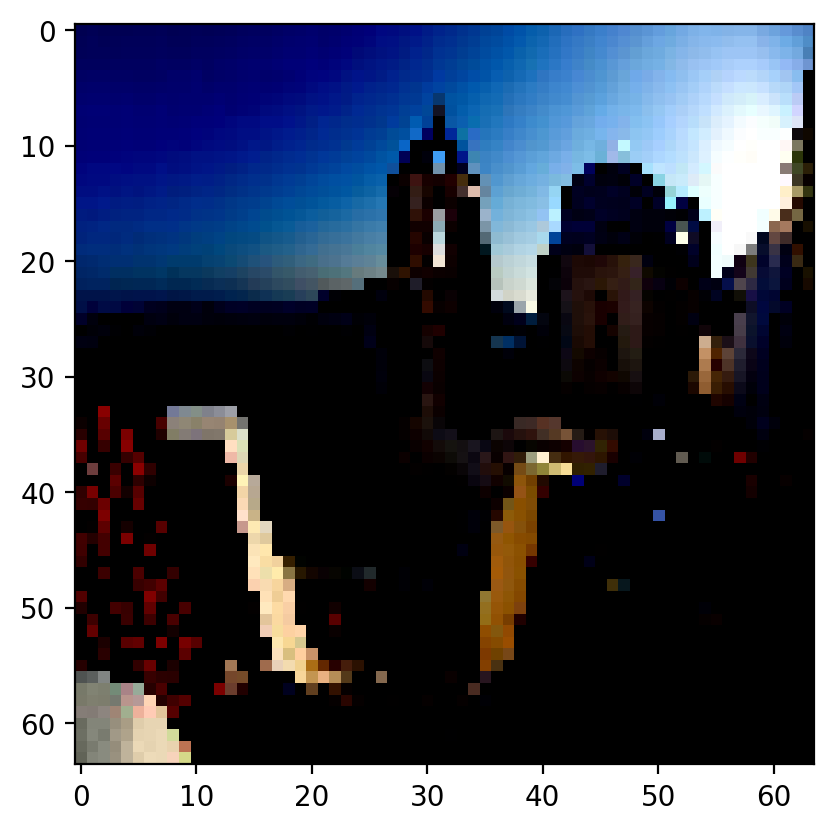

In [ ]:
imshow(next(iter(train_LSUN_dataloader)))

In [ ]:
type(next(iter(train_LSUN_dataloader)))

torch.Tensor

(64, 64, 3)
(64, 64, 3)


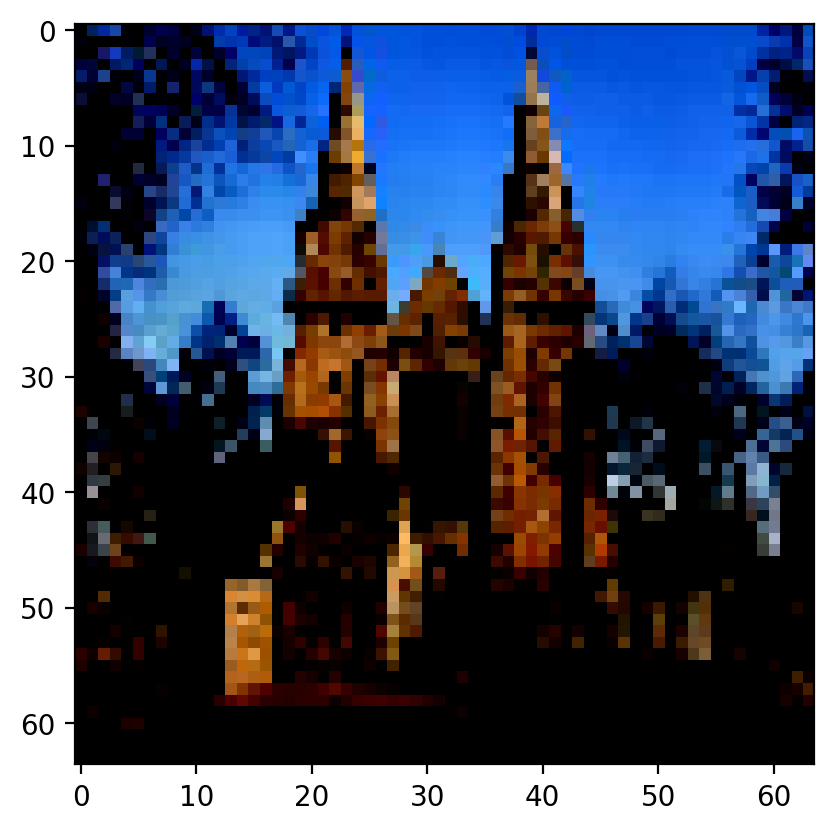

In [ ]:
#helper function to display images 
def imshow_lsun(img):
    #convert to numpy from tensor
    #image = img[0].cpu().detach().numpy() 
    image = np.transpose(img[0].cpu().detach().numpy()[0], (1, 2, 0)) 
    print(image.shape)
    plt.imshow(image)
imshow_lsun(next(iter(train_LSUN_dataloader)))



In [ ]:
dataset = "LSUN"
!mkdir {dataset}

##Training

In [ ]:
#initializing losses and image lists for GAN 
g_loss = []
d_loss = []
images =[]

In [ ]:
trainDCGAN(train_LSUN_dataloader,"LSUN",20,5)
 

Streaming output truncated to the last 5000 lines.
[7/20][183/391] Loss_D: 2.9594 Loss_G: 3.6340 D(x): 0.9995 D(G(z)): 0.9481 / 0.0264
[7/20][184/391] Loss_D: 0.3566 Loss_G: 3.4614 D(x): 0.9998 D(G(z)): 0.2998 / 0.0314
[7/20][185/391] Loss_D: 0.1510 Loss_G: 3.4315 D(x): 0.9660 D(G(z)): 0.1099 / 0.0323
[7/20][186/391] Loss_D: 0.6037 Loss_G: 5.7314 D(x): 0.5478 D(G(z)): 0.0018 / 0.0032
[7/20][187/391] Loss_D: 0.0806 Loss_G: 2.7227 D(x): 0.9995 D(G(z)): 0.0770 / 0.0657
[7/20][188/391] Loss_D: 4.8958 Loss_G: 1.5914 D(x): 0.0078 D(G(z)): 0.0427 / 0.2036
[7/20][189/391] Loss_D: 1.5932 Loss_G: 1.3105 D(x): 0.2239 D(G(z)): 0.0920 / 0.2697
[7/20][190/391] Loss_D: 0.5260 Loss_G: 1.7780 D(x): 0.8685 D(G(z)): 0.3196 / 0.1690
[7/20][191/391] Loss_D: 1.1767 Loss_G: 2.3957 D(x): 0.9977 D(G(z)): 0.6910 / 0.0911
[7/20][192/391] Loss_D: 0.7399 Loss_G: 2.8872 D(x): 0.8464 D(G(z)): 0.4363 / 0.0557
[7/20][193/391] Loss_D: 1.2391 Loss_G: 1.8579 D(x): 0.3493 D(G(z)): 0.1707 / 0.1560
[7/20][194/391] Loss_D: 0

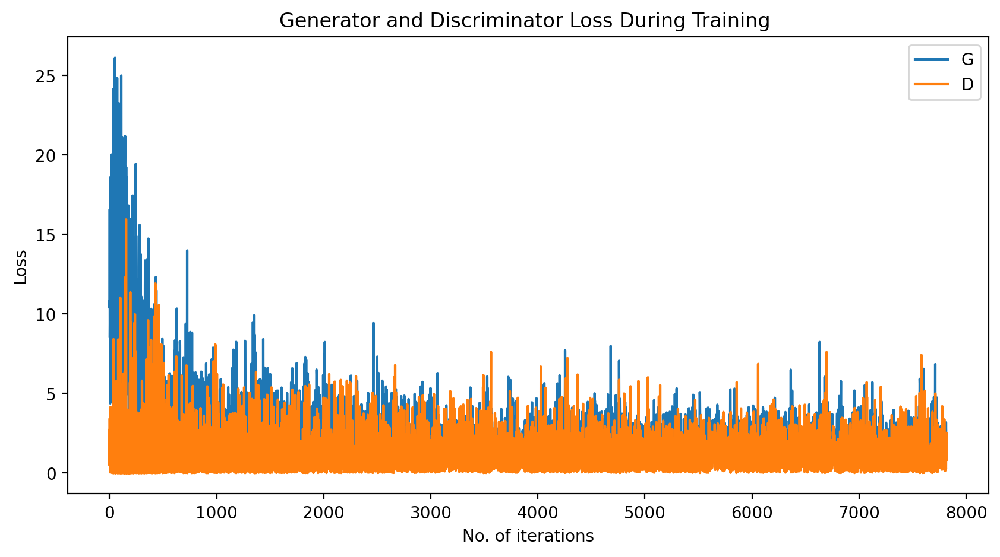

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training ")
plt.plot(g_loss,label="G")
plt.plot(d_loss,label="D")
plt.xlabel("No. of iterations")

plt.ylabel("Loss")
plt.legend()
plt.show()

## Results

In [ ]:
#load generator model checkpoint (most recent one)
genmodel = Generator(ngpu).to(device)
genmodel.load_state_dict(torch.load('LSUN_netG_epoch20.pth'))
#load discriminator model checkpoint (most recent one)
Dmodel = Discriminator(ngpu).to(device)
Dmodel.load_state_dict(torch.load('LSUN_netD_epoch20.pth'))

<All keys matched successfully>

tensor([0.2717], device='cuda:0')


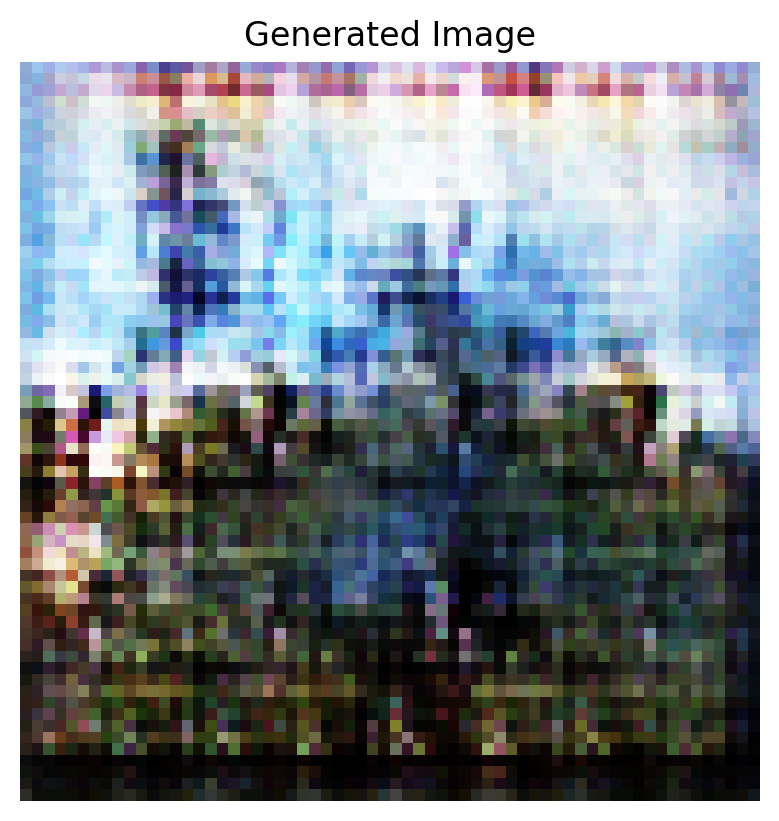

tensor([0.0722], device='cuda:0')


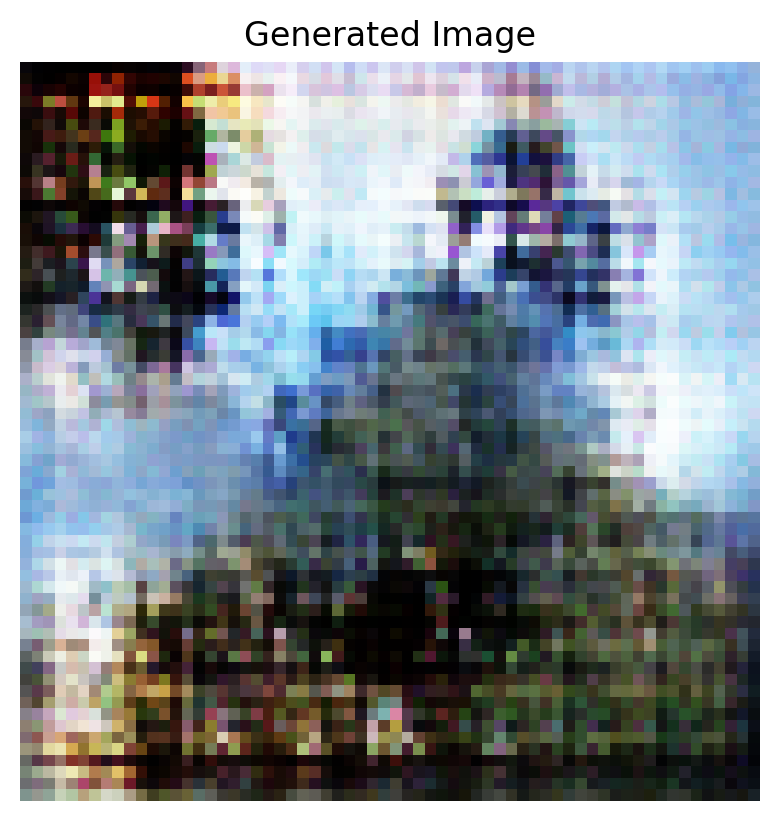

tensor([0.2646], device='cuda:0')


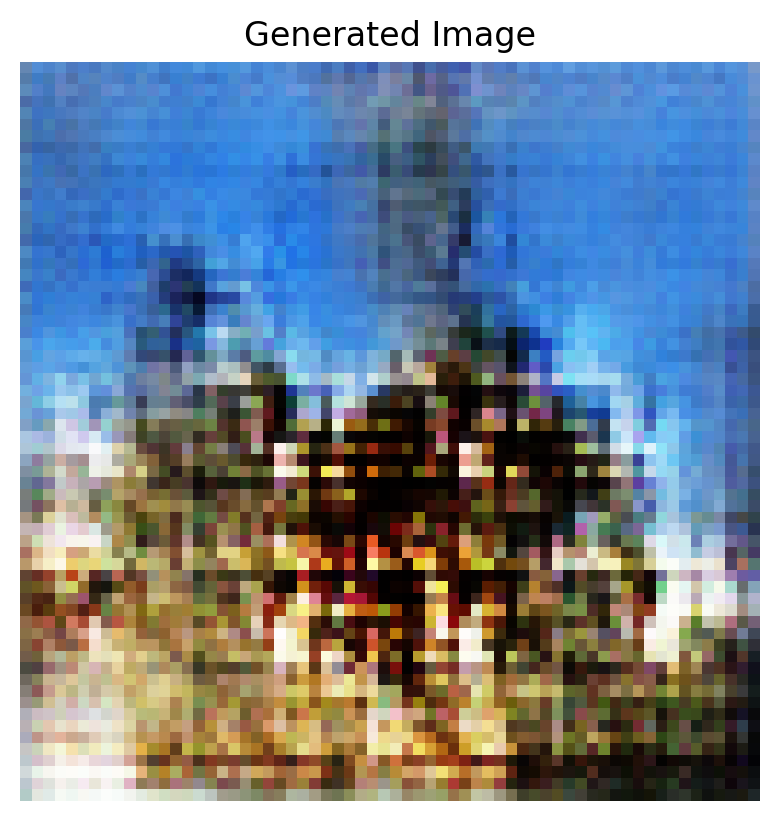

In [ ]:
# Turn off gradient calculation
for i in range(3):
    with torch.no_grad():
    # Get generated image from the noise vector using trained generator
    
      noise = torch.randn(1, 100, 1, 1, device=device)
      generated_img = genmodel(noise)
      print(Dmodel(generated_img))
      img = generated_img.detach().cpu()
      
    # Display the generated image.
    plt.axis("off")
    plt.title("Generated Image")
    plt.imshow(np.transpose(vutils.make_grid(img, padding=2, normalize=True), (1,2,0)))

    plt.show()


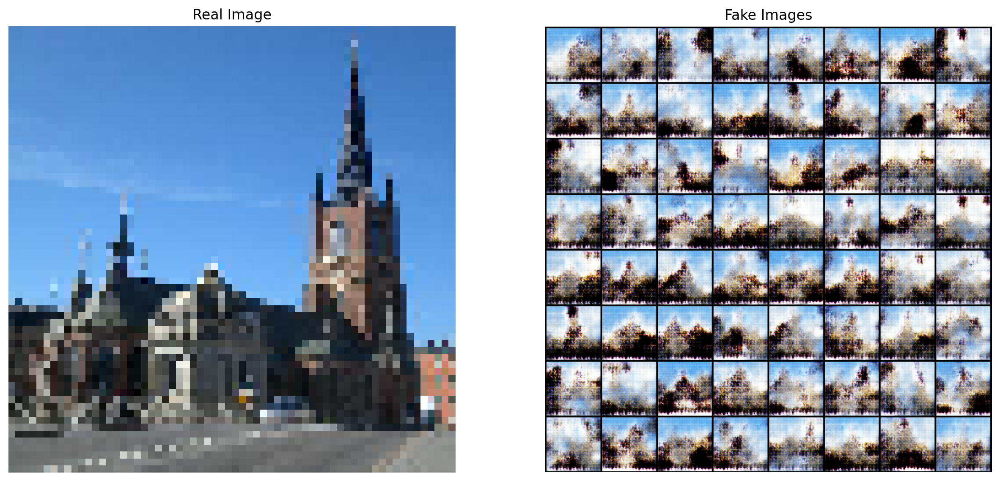

In [ ]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(train_LSUN_dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Image")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(images[-1][0:529])
plt.show()

In [ ]:
for i in range (5):
  real_img =  next(iter(train_LSUN_dataloader))[i]
  print(Dmodel(real_img.to(device)))

tensor([0.4158], device='cuda:0', grad_fn=<SqueezeBackward1>)
tensor([0.7447], device='cuda:0', grad_fn=<SqueezeBackward1>)
tensor([0.3731], device='cuda:0', grad_fn=<SqueezeBackward1>)
tensor([0.9805], device='cuda:0', grad_fn=<SqueezeBackward1>)
tensor([0.9858], device='cuda:0', grad_fn=<SqueezeBackward1>)


# Manipulating Generator Representations

In [ ]:
#load generator model checkpoint (most recent one)
genmodel = Generator(ngpu).to(device)
genmodel.load_state_dict(torch.load('/content/gdrive/MyDrive/models/Faces_netG_epoch15.pth'))


<All keys matched successfully>

In [ ]:
import tensorflow as tf
faces = []

In [ ]:
def generateCompositions(seed):
  n = 5 
  torch.manual_seed(seed)
  #fix two noise vectors
  Z1 = torch.randn(1, 100, 1, 1, device=device)
  Z2 = torch.randn(1, 100, 1, 1, device=device)

  face1 =[]
  face2 = []
  face = []
  for j in range (n):
    with torch.no_grad():
      # Get generated image from the noise vector using trained generator
        generated_img1 = genmodel(Z1)
        generated_img2 = genmodel(Z2)
        Z = Z1+Z2
        #sum of given noise vectors
        generated_img = genmodel(Z1+Z2)

        #generate images for all noise vectors
        img1 = generated_img1.detach().cpu()
        img2 = generated_img2.detach().cpu()
        img = generated_img.detach().cpu()

        face1.append(img1)
        face2.append(img2)
        face.append(img)
  #average out the faces generated by model
  avgface1 = (face1[0])/n
  avgface2 = (face2[0])/n
  avgface = (face[0])/n
  for k in range(n-1):
    avgface1 += (face1[k]/n)
    avgface2 += (face2[k])/n
    avgface += face[k]/n
#append final faces: face1, face2, face generated by Z1+Z2, face obtained by averaging pixels fo face1 and face2
  faces.append(avgface1)
  faces.append(avgface2)
  faces.append(avgface)
  faces.append((avgface1+avgface2)/2)
    

In [ ]:
for i in range(3):
    generateCompositions(i*3)
#generate faces to display

In [ ]:
faces = [np.transpose(vutils.make_grid(face, padding=1, normalize=True), (1,2,0)) for face in faces]

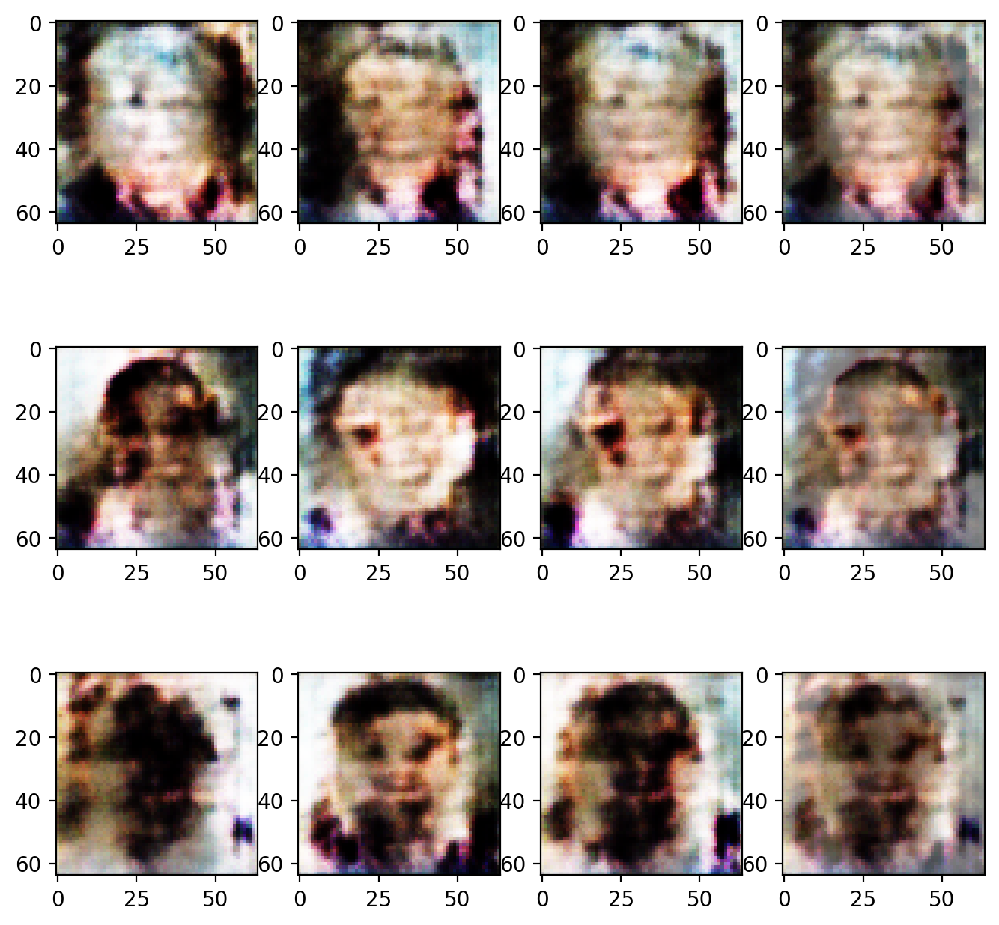

In [ ]:
imgs = faces
_, axs = plt.subplots(3, 4, figsize=(8, 8))
axs = axs.flatten()
#display faces in a grid
for img, ax in zip(imgs, axs):
    ax.imshow(img)
plt.show()

# Empirical Validation of DCGANs capabilities

## Classifying CIFAR-10 using GANs as feature extractor

The CIFAR-10 dataset can be found here: https://www.cs.toronto.edu/~kriz/cifar.html
- We will be performing classification of CIFAR-10 dataset using GANs as feature extractor.
- The performance of GANs can be determined by using them as feature extractors and evaluating the features on a linear model.
- We evaluate the quality of representations learned by DCGANs by training them on Imagenet-1k and then use the discriminator’s convolutional features from all layers, maxpooling each layers representation to produce a 4 x 4 spatial grid.

In [ ]:
#PyTorch imports
import torchvision.models as models
import torchvision.transforms as transforms
from torch.autograd import Variable
from PIL import Image
import torch

###Loading pre-trained ImageNet model

In [ ]:
# Load the pretrained model
model = Discriminator(ngpu).to(device)
model.load_state_dict(torch.load('/content/gdrive/MyDrive/IML_Project/ImageNet_netD_epoch24.pth', map_location=device))
# loading the discriminator model trained on ImageNet
model.eval() #setting it to eval mode

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)

In [ ]:
print([n for n, _ in model.named_modules()]) #checking layer info

['', 'main', 'main.0', 'main.1', 'main.2', 'main.3', 'main.4', 'main.5', 'main.6', 'main.7', 'main.8', 'main.9', 'main.10', 'main.11', 'main.12']


###Function to get feature matrix

In [ ]:
def get_vector(path, layer, index): #function to get the feature vector from image which takes layer and image path as arguments
    scaler = transforms.Resize((64, 64))
    normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    to_tensor = transforms.ToTensor()
    #few transfroms defined to get image in specific shape

    layer = model.main[layer] #selecting layer based on input
    img = Image.open(path)
    # print("shape", img)
    # 2. Create a PyTorch Variable with the transformed image
    t_img = Variable(normalize(to_tensor(scaler(img))).unsqueeze(0))
    # print(t_img)
    # 3. Create a vector of zeros that will hold our feature vector
    #    The 'avgpool' layer has an output size of 512
    my_embedding = torch.zeros(1, int(512/index), 4*index, 4*index)
    def copy_data(m, i, o):
            # print(o)
            # print(o.shape)
            my_embedding.copy_(o)
        # 5. Attach that function to our selected layer
    h = layer.register_forward_hook(copy_data)
        # 6. Run the model on our transformed image
    model(t_img.to(device))
        # 7. Detach our copy function from the layer
    h.remove()
    return my_embedding
    # 7. Detach our copy function from the layer

In [ ]:
def get_feature(path):
    op1 = get_vector(path, 8, 1)
    op2 = get_vector(path, 5, 2)
    op3 = get_vector(path, 2, 4)
    op4 = get_vector(path, 0, 8)

    # print(op1.shape)
    # print(op2.shape)
    # print(op3.shape)
    # print(op4.shape)

    #applying maxpooling on all 4 hidden layer activations 
    pooling = nn.MaxPool2d(4)
    output1 = pooling(op1)
    output2 = pooling(op2)
    output3 = pooling(op3)
    output4 = pooling(op4)
    # print(output1.shape)
    # print(output2.shape)
    # print(output3.shape)
    # print(output4.shape)
    t1 = torch.flatten(output1)
    t2 = torch.flatten(output2)
    t3 = torch.flatten(output3)
    t4 = torch.flatten(output4)
    #conctenating all activations to form final feature vector
    t1 = t1.detach().numpy()
    t2 = t2.detach().numpy()
    t3 = t3.detach().numpy()
    t4 = t4.detach().numpy()
    feature = np.concatenate((t1, t2, t3, t4))
    # feature = feature.tolist() 
    return feature

###Importing dataset from Kaggle

In [ ]:
!pip install -q kaggle #using kaggle to import dataset into colab
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"hardik373","key":"072aeeac19d6dd5632e59040d5ae78e3"}'}

In [ ]:
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets download -d swaroopkml/cifar10-pngs-in-folders #downloading dataset

100% 140M/140M [00:06<00:00, 30.9MB/s]
100% 140M/140M [00:06<00:00, 21.9MB/s]


In [ ]:
!mkdir data_cifar10_new 
!unzip cifar10-pngs-in-folders.zip -d data_cifar10_new #preparing data folder

Streaming output truncated to the last 5000 lines.
  inflating: data_cifar10_new/cifar10/cifar10/train/truck/0001.png  
  inflating: data_cifar10_new/cifar10/cifar10/train/truck/0002.png  
  inflating: data_cifar10_new/cifar10/cifar10/train/truck/0003.png  
  inflating: data_cifar10_new/cifar10/cifar10/train/truck/0004.png  
  inflating: data_cifar10_new/cifar10/cifar10/train/truck/0005.png  
  inflating: data_cifar10_new/cifar10/cifar10/train/truck/0006.png  
  inflating: data_cifar10_new/cifar10/cifar10/train/truck/0007.png  
  inflating: data_cifar10_new/cifar10/cifar10/train/truck/0008.png  
  inflating: data_cifar10_new/cifar10/cifar10/train/truck/0009.png  
  inflating: data_cifar10_new/cifar10/cifar10/train/truck/0010.png  
  inflating: data_cifar10_new/cifar10/cifar10/train/truck/0011.png  
  inflating: data_cifar10_new/cifar10/cifar10/train/truck/0012.png  
  inflating: data_cifar10_new/cifar10/cifar10/train/truck/0013.png  
  inflating: data_cifar10_new/cifar10/cifar10/train/

In [ ]:
import os #some imports needed
from os import listdir

###Getting features for training and test data

In [ ]:
def get_features(data_type, max_len): #function to get the full feature vector for all train and test images
  feature_matrix = [] # data type can be train or test
  #taking features from all 10 classes
  # get the path/directory
  folder_dir1 = "/content/data_cifar10_new/cifar10/cifar10/" + data_type + "/airplane"
  iter = 0
  for images in os.listdir(folder_dir1):
    iter = iter + 1 #specifying max no of points to be taken
    if(iter > max_len):
      iter = 0
      break
    path_img1 = folder_dir1 + '/' + images
    # print(path_img1)
    feature_matrix.append(get_feature(path_img1))
  
  folder_dir2 = "/content/data_cifar10_new/cifar10/cifar10/" + data_type + "/automobile"

  for images in os.listdir(folder_dir2):
    iter = iter + 1
    if(iter > max_len):
      iter = 0
      break
    path_img2 = folder_dir2 + '/' + images
    # print(path_img1)
    feature_matrix.append(get_feature(path_img2))
  
  folder_dir3 = "/content/data_cifar10_new/cifar10/cifar10/" + data_type + "/bird"

  for images in os.listdir(folder_dir3):
    iter = iter + 1
    if(iter > max_len):
      iter = 0
      break
    path_img3 = folder_dir3 + '/' + images
    # print(path_img1)
    feature_matrix.append(get_feature(path_img3))
  
  folder_dir4 = "/content/data_cifar10_new/cifar10/cifar10/" + data_type + "/cat"

  for images in os.listdir(folder_dir4):
    iter = iter + 1
    if(iter > max_len):
      iter = 0
      break
    path_img4 = folder_dir4 + '/' + images
    # print(path_img1)
    feature_matrix.append(get_feature(path_img4))
  
  folder_dir5 = "/content/data_cifar10_new/cifar10/cifar10/" + data_type + "/deer"

  for images in os.listdir(folder_dir5):
    iter = iter + 1
    if(iter > max_len):
      iter = 0
      break
    path_img5 = folder_dir5 + '/' + images
    # print(path_img1)
    feature_matrix.append(get_feature(path_img5))
  
  folder_dir6 = "/content/data_cifar10_new/cifar10/cifar10/" + data_type + "/dog"

  for images in os.listdir(folder_dir6):
    iter = iter + 1
    if(iter > max_len):
      iter = 0
      break
    path_img6 = folder_dir6 + '/' + images
    # print(path_img1)
    feature_matrix.append(get_feature(path_img6))
  
  folder_dir7 = "/content/data_cifar10_new/cifar10/cifar10/" + data_type + "/frog"

  for images in os.listdir(folder_dir7):
    iter = iter + 1
    if(iter > max_len):
      iter = 0
      break
    path_img7 = folder_dir7 + '/' + images
    # print(path_img1)
    feature_matrix.append(get_feature(path_img7))
  
  folder_dir8 = "/content/data_cifar10_new/cifar10/cifar10/" + data_type + "/horse"

  for images in os.listdir(folder_dir8):
    iter = iter + 1
    if(iter > max_len):
      iter = 0
      break
    path_img8 = folder_dir8 + '/' + images
    # print(path_img1)
    feature_matrix.append(get_feature(path_img8))
  
  folder_dir9 = "/content/data_cifar10_new/cifar10/cifar10/" + data_type + "/ship"

  for images in os.listdir(folder_dir9):
    iter = iter + 1
    if(iter > max_len):
      iter = 0
      break
    path_img9 = folder_dir9 + '/' + images
    # print(path_img1)
    feature_matrix.append(get_feature(path_img9))
  
  folder_dir10 = "/content/data_cifar10_new/cifar10/cifar10/" + data_type + "/truck"

  for images in os.listdir(folder_dir10):
    iter = iter + 1
    if(iter > max_len):
      iter = 0
      break
    path_img10 = folder_dir10 + '/' + images
    # print(path_img1)
    feature_matrix.append(get_feature(path_img10))
  
  feature_matrix = np.array(feature_matrix)
  return feature_matrix  

In [ ]:
train_features = get_features("train", 500) #training dataset
test_features = get_features("test", 100) #test dataset

In [ ]:
np.savetxt("train.txt", train_features) #saving for fututre purpose
np.savetxt("test.txt", test_features) #saving for fututre purpose
print(train_features.shape)
print(test_features.shape)

(5000, 7680)
(1000, 7680)


In [ ]:
train_len = 500 #making label vector for training data
y_train = []
for x in range(train_len):
  y_train.append('airplane')
for x in range(train_len):
  y_train.append('automobile')
for x in range(train_len):
  y_train.append('bird')
for x in range(train_len):
  y_train.append('cat')
for x in range(train_len):
  y_train.append('deer')
for x in range(train_len):
  y_train.append('dog')
for x in range(train_len):
  y_train.append('frog')
for x in range(train_len):
  y_train.append('horse')
for x in range(train_len):
  y_train.append('ship')
for x in range(train_len):
  y_train.append('truck')

print(y_train)

['airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'ai

In [ ]:
test_len = 100 #making label vector for test data
y_test = []
for x in range(test_len):
  y_test.append('airplane')
for x in range(test_len):
  y_test.append('automobile')
for x in range(test_len):
  y_test.append('bird')
for x in range(test_len):
  y_test.append('cat')
for x in range(test_len):
  y_test.append('deer')
for x in range(test_len):
  y_test.append('dog')
for x in range(test_len):
  y_test.append('frog')
for x in range(test_len):
  y_test.append('horse')
for x in range(test_len):
  y_test.append('ship')
for x in range(test_len):
  y_test.append('truck')

print(y_test)

['airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'airplane', 'ai

In [ ]:
np.savetxt("trainres.txt", train_features) #saving feature matrix
np.savetxt("testres.txt", test_features) #saving feature matrix

###Training RBF Kernel SVM

In [ ]:
parameters = {'gamma':[0.001, 0.01, 0.1], 'C':[0.1, 1, 10, 100]} #parameters grid for RBF Kernel svm

svc = SVC(kernel="rbf") 

clf_rbfsvm_b = GridSearchCV(svc, parameters, cv = 5, verbose = 3)

clf_rbfsvm_b.fit(train_features, y_train)

clf_rbfsvm_b.best_params_

Fitting 5 folds for each of 12 candidates, totalling 60 fits
[CV 1/5] END ................C=0.1, gamma=0.001;, score=0.771 total time=   5.2s
[CV 2/5] END ................C=0.1, gamma=0.001;, score=0.797 total time=   5.4s
[CV 3/5] END ................C=0.1, gamma=0.001;, score=0.796 total time=   4.8s
[CV 4/5] END ................C=0.1, gamma=0.001;, score=0.797 total time=   5.9s
[CV 5/5] END ................C=0.1, gamma=0.001;, score=0.794 total time=   5.0s
[CV 1/5] END .................C=0.1, gamma=0.01;, score=0.617 total time=   7.3s
[CV 2/5] END .................C=0.1, gamma=0.01;, score=0.634 total time=   7.4s
[CV 3/5] END .................C=0.1, gamma=0.01;, score=0.620 total time=   7.7s
[CV 4/5] END .................C=0.1, gamma=0.01;, score=0.636 total time=   7.3s
[CV 5/5] END .................C=0.1, gamma=0.01;, score=0.634 total time=   8.0s
[CV 1/5] END ..................C=0.1, gamma=0.1;, score=0.107 total time=   7.2s
[CV 2/5] END ..................C=0.1, gamma=0.1;

{'C': 10, 'gamma': 0.001}

In [ ]:
from sklearn.metrics import classification_report

In [ ]:
print(classification_report(clf_rbfsvm_b.predict(test_features), y_test)) #classification report

              precision    recall  f1-score   support

    airplane       0.87      0.89      0.88        98
  automobile       0.91      0.92      0.91        99
        bird       0.76      0.82      0.79        93
         cat       0.76      0.81      0.78        94
        deer       0.84      0.80      0.82       105
         dog       0.86      0.77      0.82       111
        frog       0.90      0.83      0.86       109
       horse       0.85      0.91      0.88        93
        ship       0.91      0.92      0.91        99
       truck       0.89      0.90      0.89        99

    accuracy                           0.85      1000
   macro avg       0.86      0.86      0.86      1000
weighted avg       0.86      0.85      0.85      1000



###Training linear SVM

In [ ]:
parameters = {'C':[0.01, 0.1, 1, 10]} #parameters grid for linear svm

svc = LinearSVC(max_iter = 10000)

clf_linearsvc_b = GridSearchCV(svc, parameters, verbose = 3)

clf_linearsvc_b.fit(train_features, y_train)

clf_linearsvc_b.best_params_

Fitting 5 folds for each of 4 candidates, totalling 20 fits
[CV 1/5] END ............................C=0.01;, score=0.839 total time=   3.1s
[CV 2/5] END ............................C=0.01;, score=0.847 total time=   1.9s
[CV 3/5] END ............................C=0.01;, score=0.845 total time=   2.0s
[CV 4/5] END ............................C=0.01;, score=0.845 total time=   1.9s
[CV 5/5] END ............................C=0.01;, score=0.828 total time=   2.0s
[CV 1/5] END .............................C=0.1;, score=0.790 total time=  10.6s
[CV 2/5] END .............................C=0.1;, score=0.815 total time=  10.9s
[CV 3/5] END .............................C=0.1;, score=0.806 total time=  10.5s
[CV 4/5] END .............................C=0.1;, score=0.813 total time=  10.0s
[CV 5/5] END .............................C=0.1;, score=0.808 total time=  11.2s


/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


[CV 1/5] END ...............................C=1;, score=0.774 total time=  30.3s


/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


[CV 2/5] END ...............................C=1;, score=0.787 total time=  32.6s


/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


[CV 3/5] END ...............................C=1;, score=0.792 total time=  30.3s


/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


[CV 4/5] END ...............................C=1;, score=0.779 total time=  29.4s


/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


[CV 5/5] END ...............................C=1;, score=0.786 total time=  29.4s


/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


[CV 1/5] END ..............................C=10;, score=0.768 total time=  30.8s


/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


[CV 2/5] END ..............................C=10;, score=0.781 total time=  31.6s


/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


[CV 3/5] END ..............................C=10;, score=0.786 total time=  30.9s


/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


[CV 4/5] END ..............................C=10;, score=0.767 total time=  29.4s


/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


[CV 5/5] END ..............................C=10;, score=0.774 total time=  29.8s


{'C': 0.01}

In [ ]:
print(classification_report(clf_linearsvc_b.predict(test_features), y_test)) #classification report

              precision    recall  f1-score   support

    airplane       0.80      0.84      0.82        95
  automobile       0.92      0.94      0.93        98
        bird       0.72      0.85      0.78        85
         cat       0.71      0.80      0.75        89
        deer       0.82      0.80      0.81       103
         dog       0.84      0.79      0.81       107
        frog       0.90      0.78      0.84       115
       horse       0.88      0.92      0.90        96
        ship       0.96      0.85      0.90       113
       truck       0.90      0.91      0.90        99

    accuracy                           0.84      1000
   macro avg       0.84      0.85      0.84      1000
weighted avg       0.85      0.84      0.85      1000



##Classifying SVHN Dataset using GANs as feature extractor 

The SVHN dataset can be found here: https://www.kaggle.com/datasets/hugovallejo/street-view-house-numbers-svhn-dataset-numpy

- There are 73257 digits for training and 26032 digits for testing
- All images are 32X32 in size
- There are 10 classes, 1 for each digit. Digit '1' has label 1, '9' has label 9 and '0' has label 10.

### Loading dataset from Kaggle

In [ ]:
!kaggle datasets download -d hugovallejo/street-view-house-numbers-svhn-dataset-numpy #downloading dataset

 95% 335M/352M [00:02<00:00, 171MB/s]
100% 352M/352M [00:02<00:00, 125MB/s]


In [ ]:
!mkdir data_SVHN
!unzip street-view-house-numbers-svhn-dataset-numpy.zip -d data_SVHN

Archive:  street-view-house-numbers-svhn-dataset-numpy.zip
  inflating: data_SVHN/X_test.npy    
  inflating: data_SVHN/X_train.npy   
  inflating: data_SVHN/y_test.npy    
  inflating: data_SVHN/y_train.npy   


In [ ]:
data = np.load('/content/data_SVHN/X_test.npy') #loading train and test data and label
label = np.load('/content/data_SVHN/y_test.npy')
test = np.load('/content/data_SVHN/X_test.npy')
test_label = np.load('/content/data_SVHN/y_test.npy')

In [ ]:
x = np.transpose(data, (3,2,0,1)) #making data into proper shape
print(x.shape)

(26032, 3, 32, 32)


In [ ]:
print(label) 

[[5]
 [2]
 [1]
 ...
 [7]
 [6]
 [7]]


###Getting features for training and test data

In [ ]:
train_SVHN = [] #extracting features for train and test dataset
train_SVHN_y = []
for i in range(10000): #10000 train images
  train_SVHN.append(get_feature2(x[i]))
  train_SVHN_y.append(label[i])
train_SVHN = np.array(train_SVHN)
train_SVHN_y = np.array(train_SVHN_y)
train_SVHN_y = train_SVHN_y.reshape(10000,)

In [ ]:
test_SVHN = [] #extracting features for train and test dataset
test_SVHN_y = []
for i in range(20000, 22000): #2000 train images
  test_SVHN.append(get_feature2(x[i]))
  test_SVHN_y.append(label[i])
test_SVHN = np.array(test_SVHN)
test_SVHN_y = np.array(test_SVHN_y)
test_SVHN_y = test_SVHN_y.reshape(2000,)

###Training RBF Kernel SVM

In [ ]:
parameters = {'gamma':[0.001, 0.01], 'C':[1, 10, 100]} #parameters grid for RBF Kernel svm

svc = SVC(kernel="rbf")

clf_rbfsvm_b = GridSearchCV(svc, parameters, cv = 5, verbose = 3)

clf_rbfsvm_b.fit(train_SVHN, train_SVHN_y)

clf_rbfsvm_b.best_params_

Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END ..................C=1, gamma=0.001;, score=0.490 total time=  15.1s
[CV 2/5] END ..................C=1, gamma=0.001;, score=0.514 total time=  14.5s
[CV 3/5] END ..................C=1, gamma=0.001;, score=0.514 total time=  14.8s
[CV 4/5] END ..................C=1, gamma=0.001;, score=0.503 total time=  14.9s
[CV 5/5] END ..................C=1, gamma=0.001;, score=0.523 total time=  14.0s
[CV 1/5] END ...................C=1, gamma=0.01;, score=0.519 total time=  15.5s
[CV 2/5] END ...................C=1, gamma=0.01;, score=0.532 total time=  16.0s
[CV 3/5] END ...................C=1, gamma=0.01;, score=0.540 total time=  16.1s
[CV 4/5] END ...................C=1, gamma=0.01;, score=0.526 total time=  16.3s
[CV 5/5] END ...................C=1, gamma=0.01;, score=0.552 total time=  15.8s
[CV 1/5] END .................C=10, gamma=0.001;, score=0.548 total time=  12.4s
[CV 2/5] END .................C=10, gamma=0.001;,

{'C': 10, 'gamma': 0.001}

In [ ]:
print(classification_report(clf_rbfsvm_b.predict(test_SVHN), test_SVHN_y)) #classification report

              precision    recall  f1-score   support

           0       0.78      0.58      0.66       152
           1       0.81      0.62      0.70       508
           2       0.64      0.58      0.61       359
           3       0.37      0.39      0.38       221
           4       0.57      0.63      0.60       172
           5       0.44      0.55      0.49       164
           6       0.48      0.57      0.52       119
           7       0.50      0.64      0.56       129
           8       0.38      0.51      0.43        90
           9       0.38      0.50      0.43        86

    accuracy                           0.57      2000
   macro avg       0.53      0.56      0.54      2000
weighted avg       0.60      0.57      0.58      2000



###Training linear SVM

In [ ]:
parameters = {'C':[0.01, 0.1]} #parameters grid for linear svm

svc = LinearSVC(max_iter = 10000)

clf_linearsvc_b = GridSearchCV(svc, parameters, verbose = 3)

clf_linearsvc_b.fit(train_SVHN, train_SVHN_y)

clf_linearsvc_b.best_params_

Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END ............................C=0.01;, score=0.563 total time=   4.7s
[CV 2/5] END ............................C=0.01;, score=0.577 total time=   6.5s
[CV 3/5] END ............................C=0.01;, score=0.585 total time=   4.5s
[CV 4/5] END ............................C=0.01;, score=0.581 total time=   5.4s
[CV 5/5] END ............................C=0.01;, score=0.580 total time=   4.7s
[CV 1/5] END .............................C=0.1;, score=0.559 total time=  40.9s
[CV 2/5] END .............................C=0.1;, score=0.564 total time=  34.3s
[CV 3/5] END .............................C=0.1;, score=0.580 total time=  40.3s
[CV 4/5] END .............................C=0.1;, score=0.560 total time=  38.3s
[CV 5/5] END .............................C=0.1;, score=0.579 total time=  36.3s


{'C': 0.01}

In [ ]:
print(classification_report(clf_linearsvc_b.predict(test_SVHN), test_SVHN_y)) #classification report

              precision    recall  f1-score   support

           0       0.81      0.61      0.69       152
           1       0.80      0.65      0.72       485
           2       0.63      0.58      0.61       358
           3       0.32      0.40      0.36       189
           4       0.59      0.58      0.58       190
           5       0.49      0.57      0.52       175
           6       0.47      0.55      0.51       122
           7       0.56      0.62      0.59       151
           8       0.39      0.53      0.45        90
           9       0.35      0.45      0.40        88

    accuracy                           0.57      2000
   macro avg       0.54      0.55      0.54      2000
weighted avg       0.60      0.57      0.58      2000



# References

- https://www.analyticsvidhya.com/blog/2021/07/deep-convolutional-generative-adversarial-network-dcgan-for-beginners/
- https://github.com/eriklindernoren/PyTorch-GAN/blob/master/implementations/dcgan/dcgan.py
- https://github.com/Newmu/dcgan_code
- https://becominghuman.ai/extract-a-feature-vector-for-any-image-with-pytorch-9717561d1d4c
- https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html